<a href="https://colab.research.google.com/github/CarlosCastillo99/Parcial-1-HE2-IA/blob/main/Copia_de_Monitoria_Parcial1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Instalación de Bibliotecas y Carga del Dataset

En esta sección se realiza la instalación de todas las bibliotecas necesarias para trabajar, al igual que el dataset desde Kaggle.

In [12]:
!pip install kaggle ydata_profiling -q

In [13]:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None) # Quitar el límite de columnas a mostrar en un DataFrame
from google.colab import files
from numpy import sqrt
from ydata_profiling import ProfileReport

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, StandardScaler, LabelEncoder, FunctionTransformer, OneHotEncoder
from sklearn.metrics import mean_squared_error, mean_absolute_error, confusion_matrix, classification_report, ConfusionMatrixDisplay

SEED = 2025

In [14]:
!kaggle datasets download -d uciml/pima-indians-diabetes-database


Dataset URL: https://www.kaggle.com/datasets/uciml/pima-indians-diabetes-database
License(s): CC0-1.0
pima-indians-diabetes-database.zip: Skipping, found more recently modified local copy (use --force to force download)


In [15]:
ROOT_DIR = '/content'
DATASET_NAME = 'pima-indians-diabetes-database'

%cd {ROOT_DIR}
!unzip -o {DATASET_NAME}.zip -d {ROOT_DIR}/{DATASET_NAME}


/content
Archive:  pima-indians-diabetes-database.zip
  inflating: /content/pima-indians-diabetes-database/diabetes.csv  


### 1. **Explicación del dataset**

La diabetes tipo 2 es una de las enfermedades crónicas más prevalentes en la población mundial, afectando significativamente la calidad de vida de quienes la padecen. Factores como la genética, el estilo de vida, la alimentación y la obesidad influyen en el desarrollo de la enfermedad. Este conjunto de datos, obtenido del Instituto Nacional de Diabetes y Enfermedades Digestivas y Renales (NIDDK), busca analizar qué factores pueden estar asociados con la presencia de diabetes en una población específica.

El dataset Pima Indians Diabetes se enfoca en un grupo de mujeres de origen Pima (una comunidad indígena de EE. UU.), mayores de 21 años, para determinar la presencia de diabetes. La variable objetivo es Outcome, que indica si una persona ha sido diagnosticada con diabetes (1) o no (0). El análisis de estos datos permitirá identificar los factores más relevantes para predecir la enfermedad y diseñar estrategias preventivas.

El objetivo del estudio es analizar qué factores tienen mayor influencia en la presencia de diabetes y construir modelos predictivos para facilitar su diagnóstico temprano.

La base de datos cuenta con las siguientes variables:

| **Columna**                     | **Descripción**                                                                |
|---------------------------------|-------------------------------------------------------------------------------|
| **Pregnancies**                 | Número de embarazos.                                                         |
| **Glucose**                     | Nivel de glucosa en sangre (mg/dL).                                          |
| **BloodPressure**               | Presión arterial diastólica (mm Hg).                                        |
| **SkinThickness**               | Espesor del pliegue cutáneo del tríceps (mm).                               |
| **Insulin**                     | Nivel de insulina en suero (mu U/ml).                                       |
| **BMI**                         | Índice de Masa Corporal (peso en kg / altura en m²).                        |
| **DiabetesPedigreeFunction**    | Función de pedigrí de diabetes (probabilidad de desarrollar diabetes).       |
| **Age**                         | Edad en años.                                                               |
| **Outcome**                     | Diagnóstico de diabetes (0 = No, 1 = Sí).                                   |


In [16]:
df = pd.read_csv(f'{ROOT_DIR}/{DATASET_NAME}/diabetes.csv')
# Remover espacios de inicio y final de los títulos de las columnas
df.columns = df.columns.str.strip()
df


,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


In [17]:
df.info()
df.head()
df.shape

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 768 entries, 0 to 767
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               768 non-null    int64  
 1   Glucose                   768 non-null    int64  
 2   BloodPressure             768 non-null    int64  
 3   SkinThickness             768 non-null    int64  
 4   Insulin                   768 non-null    int64  
 5   BMI                       768 non-null    float64
 6   DiabetesPedigreeFunction  768 non-null    float64
 7   Age                       768 non-null    int64  
 8   Outcome                   768 non-null    int64  
dtypes: float64(2), int64(7)
memory usage: 54.1 KB


(768, 9)

In [18]:
from sklearn.model_selection import train_test_split

# División estratificada de datos (80% entrenamiento, 20% prueba)
# stratify=df['Outcome'] asegura que la proporción de las clases se mantenga en ambos conjuntos
df_train, df_test = train_test_split(
    df,                      # DataFrame completo
    test_size=0.2,           # 20% para prueba
    random_state=SEED,       # Semilla para reproducibilidad
    stratify=df['Outcome']   # Mantiene la proporción de clases en la columna 'Outcome'
)

# Mostrar las primeras filas de cada conjunto
display(df_train.head())
display(df_test.head())

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
288,4,96,56,17,49,20.8,0.340,26,0
622,6,183,94,0,0,40.8,1.461,45,0
727,0,141,84,26,0,32.4,0.433,22,0
55,1,73,50,10,0,23.0,0.248,21,0
699,4,118,70,0,0,44.5,0.904,26,0


,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
71,5,139,64,35,140,28.6,0.411,26,0
436,12,140,85,33,0,37.4,0.244,41,0
345,8,126,88,36,108,38.5,0.349,49,0
289,5,108,72,43,75,36.1,0.263,33,0
543,4,84,90,23,56,39.5,0.159,25,0


### 2. **Análisis descriptivo**

El conjunto de datos de Pima Indians Diabetes Database contiene información sobre diversas características médicas y demográficas de pacientes indígenas Pima. El objetivo principal es predecir si un paciente tiene diabetes en función de estas características.

Se realiza un análisis descriptivo para explorar las características principales y obtener una mejor comprensión de los datos antes de realizar los modelos predictivos. Esto incluye la revisión de la distribución de las variables, detección de valores atípicos, correlaciones y posibles relaciones entre las características y la variable objetivo (Outcome, que indica si un paciente tiene o no diabetes).

In [19]:
# Resumen de las columnas, tipos de datos y valores faltantes
print(df_train.info())
print()
print(df_test.info())

<class 'pandas.core.frame.DataFrame'>
Index: 614 entries, 288 to 370
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               614 non-null    int64  
 1   Glucose                   614 non-null    int64  
 2   BloodPressure             614 non-null    int64  
 3   SkinThickness             614 non-null    int64  
 4   Insulin                   614 non-null    int64  
 5   BMI                       614 non-null    float64
 6   DiabetesPedigreeFunction  614 non-null    float64
 7   Age                       614 non-null    int64  
 8   Outcome                   614 non-null    int64  
dtypes: float64(2), int64(7)
memory usage: 48.0 KB
None

<class 'pandas.core.frame.DataFrame'>
Index: 154 entries, 71 to 530
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies           

In [20]:
# Análisis descriptivo de los datos de entrenamiento
reporte = ProfileReport(df, title="Profiling Report")
reporte.to_file("report.html")
reporte

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [21]:
# Análisis descriptivo de los datos de entrenamiento
reporte = ProfileReport(df_train, title="Profiling Report")
reporte.to_file("report.html")
reporte

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [22]:
# Análisis descriptivo de los datos de entrenamiento
reporte = ProfileReport(df_test, title="Profiling Report")
reporte.to_file("report.html")
reporte

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

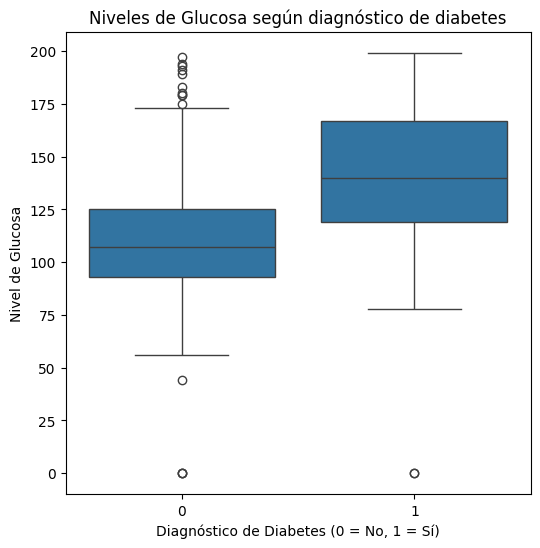

In [23]:
# Boxplot para comparar 'Glucose' según 'Outcome' (No diabético vs Diabético)
plt.figure(figsize=(6, 6))
sns.boxplot(x='Outcome', y='Glucose', data=df)
plt.title('Niveles de Glucosa según diagnóstico de diabetes')
plt.xlabel('Diagnóstico de Diabetes (0 = No, 1 = Sí)')
plt.ylabel('Nivel de Glucosa')
plt.show()


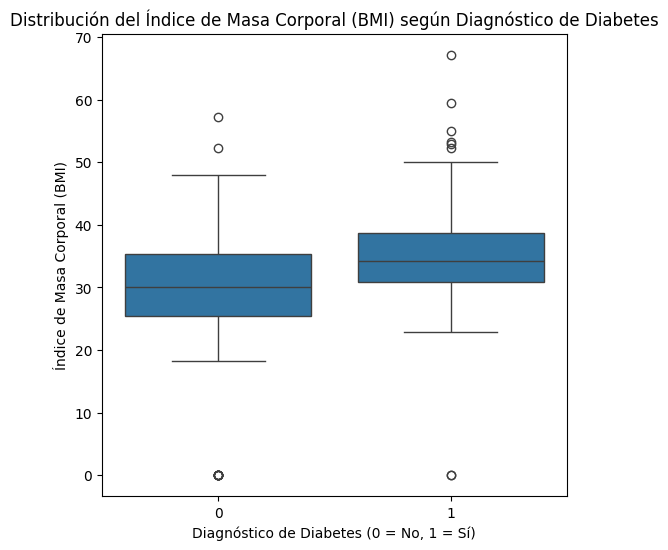

In [24]:
# Boxplot para comparar 'BMI' según 'Outcome' (Diagnóstico de Diabetes)
plt.figure(figsize=(6, 6))
sns.boxplot(x='Outcome', y='BMI', data=df)
plt.title('Distribución del Índice de Masa Corporal (BMI) según Diagnóstico de Diabetes')
plt.xlabel('Diagnóstico de Diabetes (0 = No, 1 = Sí)')
plt.ylabel('Índice de Masa Corporal (BMI)')
plt.show()


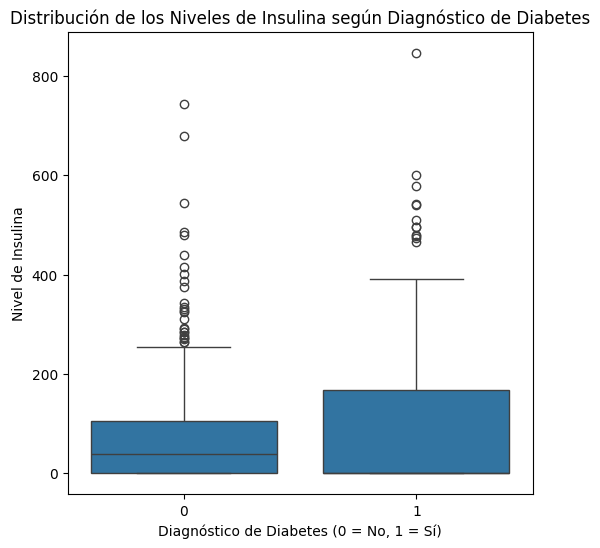

In [25]:
# Boxplot para comparar 'Insulin' según 'Outcome' (Diagnóstico de Diabetes)
plt.figure(figsize=(6, 6))
sns.boxplot(x='Outcome', y='Insulin', data=df)
plt.title('Distribución de los Niveles de Insulina según Diagnóstico de Diabetes')
plt.xlabel('Diagnóstico de Diabetes (0 = No, 1 = Sí)')
plt.ylabel('Nivel de Insulina')
plt.show()


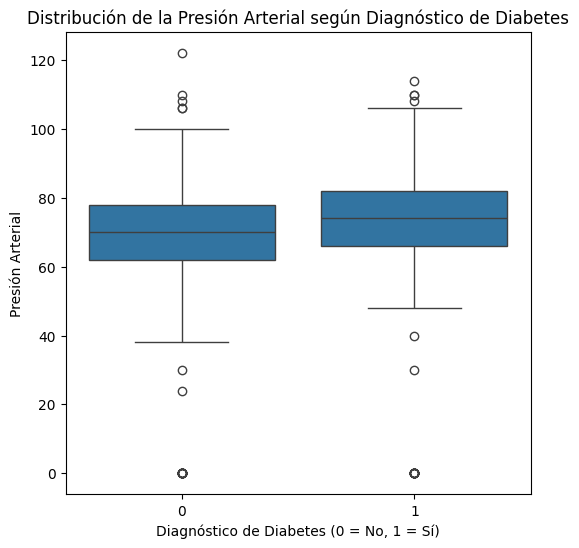

In [26]:
# Boxplot para comparar 'BloodPressure' según 'Outcome' (Diagnóstico de Diabetes)
plt.figure(figsize=(6, 6))
sns.boxplot(x='Outcome', y='BloodPressure', data=df)
plt.title('Distribución de la Presión Arterial según Diagnóstico de Diabetes')
plt.xlabel('Diagnóstico de Diabetes (0 = No, 1 = Sí)')
plt.ylabel('Presión Arterial')
plt.show()


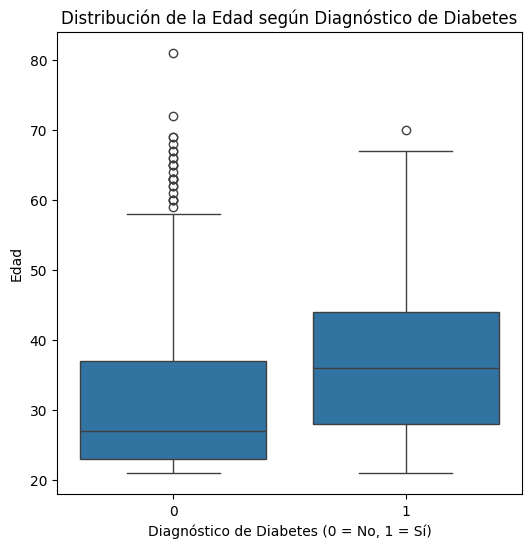

In [27]:
# Boxplot para comparar 'Age' según 'Outcome' (Diagnóstico de Diabetes)
plt.figure(figsize=(6, 6))
sns.boxplot(x='Outcome', y='Age', data=df)
plt.title('Distribución de la Edad según Diagnóstico de Diabetes')
plt.xlabel('Diagnóstico de Diabetes (0 = No, 1 = Sí)')
plt.ylabel('Edad')
plt.show()


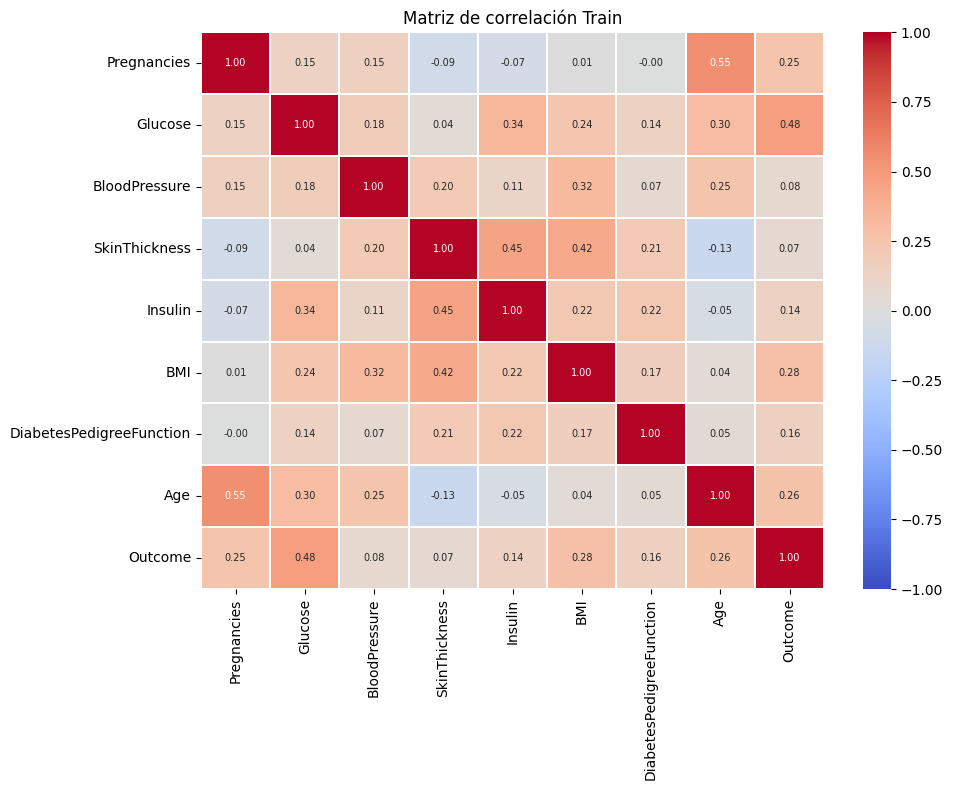

In [28]:
# Seleccionar solo las columnas numéricas
numeric_df = df_train.select_dtypes(include=['float64', 'int64'])

# Calcular la matriz de correlación
correlation_matrix = numeric_df.corr()

# Grafico
plt.figure(figsize=(10, 8))

sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1,
            annot_kws={"size": 7}, fmt=".2f", linewidths=0.3)

plt.title('Matriz de correlación Train', fontsize=12)
plt.tight_layout()
plt.show()

*   **¿Qué teorías puede plantear a partir de este análisis sobre la variable objetivo?**

  A partir del análisis de la matriz de correlación, se puede plantear la hipótesis de que los niveles de glucosa en sangre son el factor más determinante en el diagnóstico de diabetes, ya que presentan la correlación más alta con la variable Outcome (0.47). Esto coincide con el conocimiento médico, donde la hiperglucemia es un criterio clave para diagnosticar la enfermedad. Además, se observa una correlación moderada entre BMI (0.27) y Outcome, lo que sugiere que el sobrepeso o la obesidad podrían influir en la probabilidad de desarrollar diabetes. Otra variable con cierta correlación es la Edad (0.22), lo que podría indicar que la diabetes tiende a manifestarse con mayor frecuencia en personas mayores. Esto sugiere que el envejecimiento y el aumento del índice de masa corporal podrían ser factores de riesgo relevantes a considerar en modelos predictivos de diabetes.
  
*   **¿Existen variables con alta correlación?**

  En la matriz de correlación se destacan algunas relaciones importantes. La más fuerte se da entre Age y Pregnancies (0.56), lo cual es esperable, ya que a medida que una mujer envejece, tiene más probabilidades de haber tenido múltiples embarazos. También hay una correlación moderada entre Insulin y SkinThickness (0.42), lo que sugiere que el grosor del pliegue cutáneo puede estar relacionado con la cantidad de insulina en el cuerpo, posiblemente debido a su papel en la acumulación de grasa y metabolismo. Además, la correlación entre BMI y SkinThickness (0.40) sugiere que las personas con mayor índice de masa corporal tienden a tener pliegues cutáneos más gruesos. Estas correlaciones pueden ser útiles al momento de construir modelos, pero también podrían indicar redundancia en la información.

*   **¿Hay variables que se podrían eliminar? ¿Por qué?**

  Si bien no hay correlaciones extremadamente altas que indiquen colinealidad fuerte (mayor a 0.8), algunas variables podrían ser redundantes en el análisis. Por ejemplo, dado que SkinThickness e Insulin tienen una correlación moderada, podría evaluarse si una de ellas aporta más información que la otra en la predicción de la diabetes. Si ambas están midiendo aspectos similares del metabolismo, una podría eliminarse sin afectar demasiado el modelo. Asimismo, la relación entre Age y Pregnancies podría indicar que una de estas variables aporta información redundante en determinados casos. Si en un análisis más profundo se demuestra que la edad es suficiente para capturar la tendencia de embarazos acumulados, Pregnancies podría ser eliminada o usada de forma secundaria. En general, estas decisiones deben tomarse tras evaluar su impacto en la predicción y realizar pruebas de reducción de dimensionalidad o análisis de importancia de variables.


### 3. Procesamiento inicial

In [29]:
# Eliminar valores NA de la variable de interes
df_train = df_train.dropna(subset=['Outcome'])
df_test = df_test.dropna(subset=['Outcome'])

In [30]:
# Ahora separamos los datos de entrada en X como variables explicativas y la variable a predecir Y en df_train
X_train, y_train = df_train.drop(['Outcome'], axis=1), df_train['Outcome']
display(X_train.head())
y_train.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
288,4,96,56,17,49,20.8,0.340,26
622,6,183,94,0,0,40.8,1.461,45
727,0,141,84,26,0,32.4,0.433,22
55,1,73,50,10,0,23.0,0.248,21
699,4,118,70,0,0,44.5,0.904,26


,Outcome
288,0
622,0
727,0
55,0
699,0


In [31]:
# Separar los datos en variables explicativas (X) y la variable objetivo (y) para el conjunto de prueba
X_test, y_test = df_test.drop(['Outcome'], axis=1), df_test['Outcome']

# Mostrar las primeras filas de los datos de entrada y la variable objetivo en el conjunto de prueba
display(X_test.head())
y_test.head()


,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
71,5,139,64,35,140,28.6,0.411,26
436,12,140,85,33,0,37.4,0.244,41
345,8,126,88,36,108,38.5,0.349,49
289,5,108,72,43,75,36.1,0.263,33
543,4,84,90,23,56,39.5,0.159,25


,Outcome
71,0
436,0
345,0
289,0
543,0


In [32]:
X_train.isnull().sum()

,0
Pregnancies,0
Glucose,0
BloodPressure,0
SkinThickness,0
Insulin,0
BMI,0
DiabetesPedigreeFunction,0
Age,0


In [33]:
X_test.isnull().sum()

,0
Pregnancies,0
Glucose,0
BloodPressure,0
SkinThickness,0
Insulin,0
BMI,0
DiabetesPedigreeFunction,0
Age,0


En este análisis, se han aplicado técnicas de imputación para reemplazar valores inconsistentes en algunas variables. Aunque el dataset no contiene valores nulos, variables como BloodPressure, SkinThickness, Insulin y BMI presentaban valores en cero, los cuales no son realistas desde una perspectiva médica.

Estos ceros pueden representar datos faltantes en lugar de valores reales, ya que, por ejemplo, una presión arterial de 0 no es posible en términos fisiológicos. Para abordar este problema, se han reemplazado estos valores con la media de la variable mediante la técnica de imputación con SimpleImputer. Esto permite mejorar la calidad de los datos sin introducir sesgos significativos.

Con esta corrección, el dataset queda más alineado con la realidad médica y facilita un mejor desempeño del modelo. En etapas posteriores del preprocesamiento, se evaluará el impacto de esta imputación y si es necesario aplicar técnicas adicionales, como la eliminación de valores atípicos o enfoques más avanzados para mejorar la precisión del modelo.


In [35]:
from sklearn.impute import SimpleImputer
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split

# Listado de columnas donde 0 puede indicar datos faltantes
columns_to_impute = ['BloodPressure', 'SkinThickness', 'Insulin', 'BMI']

# Reemplazar valores 0 por NaN antes de la imputación
df[columns_to_impute] = df[columns_to_impute].replace(0, np.nan)

# Crear el imputador para reemplazar valores NaN por la media de la columna
imputer = SimpleImputer(strategy='mean')
df[columns_to_impute] = imputer.fit_transform(df[columns_to_impute])

# División de datos en Train/Test
X = df.drop(columns=['Outcome'])
y = df['Outcome']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Verificar que no haya más valores de 0 en estas columnas
print((X_train[columns_to_impute] == 0).sum())
print((X_test[columns_to_impute] == 0).sum())

print(" Imputación completada correctamente.")


BloodPressure    0
SkinThickness    0
Insulin          0
BMI              0
dtype: int64
BloodPressure    0
SkinThickness    0
Insulin          0
BMI              0
dtype: int64
 Imputación completada correctamente.


In [36]:
X_train.isnull().sum()

,0
Pregnancies,0
Glucose,0
BloodPressure,0
SkinThickness,0
Insulin,0
BMI,0
DiabetesPedigreeFunction,0
Age,0


In [37]:
X_train.isnull().sum()

,0
Pregnancies,0
Glucose,0
BloodPressure,0
SkinThickness,0
Insulin,0
BMI,0
DiabetesPedigreeFunction,0
Age,0


In [38]:
from sklearn.preprocessing import StandardScaler
import pandas as pd

# Inicializar el escalador
scaler = StandardScaler()

# Ajustar y transformar el conjunto de entrenamiento
X_train_scaled = pd.DataFrame(scaler.fit_transform(X_train), columns=X_train.columns)

# Transformar el conjunto de prueba (sin volver a ajustar)
X_test_scaled = pd.DataFrame(scaler.transform(X_test), columns=X_test.columns)

# Verificar resultados
print("Escalado completado. Primeras filas del conjunto escalado:")
print(X_train_scaled.head())

Escalado completado. Primeras filas del conjunto escalado:
   Pregnancies   Glucose  BloodPressure  SkinThickness   Insulin       BMI  \
0    -0.851355 -0.980131      -0.827973      -1.923095 -1.401946 -0.769818   
1     0.356576  0.161444       0.476532      -0.234795 -1.671715 -0.417838   
2    -0.549372 -0.504474      -1.154099       1.228400 -0.746792  0.359453   
3    -0.851355  0.795653      -1.317162       0.007580  0.043866 -0.403172   
4    -1.153338 -0.821579      -0.664910       1.115846 -0.605484  1.782040   

   DiabetesPedigreeFunction       Age  
0                  0.310794 -0.792169  
1                 -0.116439  0.561034  
2                 -0.764862 -0.707594  
3                  0.262314 -0.369293  
4                 -0.337630 -0.961320  


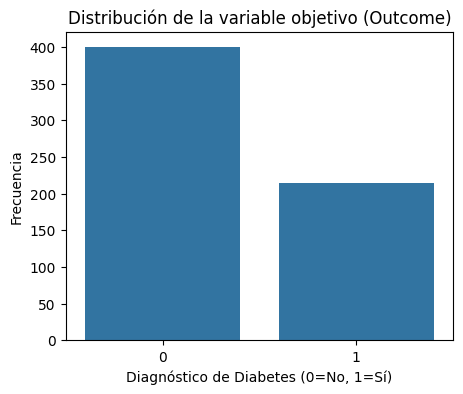

,proportion
Outcome,
0,65.14658
1,34.85342


In [40]:
# Verificar distribución de la variable objetivo
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(5, 4))
sns.countplot(x=y_train)
plt.title("Distribución de la variable objetivo (Outcome)")
plt.xlabel("Diagnóstico de Diabetes (0=No, 1=Sí)")
plt.ylabel("Frecuencia")
plt.show()

# Ver porcentajes de cada clase
y_train.value_counts(normalize=True) * 100


In [41]:
display(y_train)

,Outcome
353,0
711,0
373,0
46,0
682,0
...,...
451,1
113,0
556,0
667,1


## Modelos

#### Clasificación

In [60]:
# Importar modelos de clasificación
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import numpy as np
from sklearn.model_selection import GridSearchCV
import matplotlib.pyplot as plt

# Semilla para reproducibilidad
SEED = 2025


In [61]:
def train_and_evaluate_classification(models, param_grids, X_train, y_train, X_test, y_test, scoring='recall_weighted'):
    results = {}
    best_estimators = {}

    for name, model in models.items():
        print(f"Entrenando {name}...")

        # Búsqueda de hiperparámetros con GridSearchCV
        grid_search = GridSearchCV(model, param_grids[name], cv=3, scoring=scoring, n_jobs=-1)
        grid_search.fit(X_train, y_train)

        # Mejor modelo encontrado
        best_model = grid_search.best_estimator_
        best_estimators[name] = best_model

        # Predicciones en train y test
        y_train_pred = best_model.predict(X_train)
        y_test_pred = best_model.predict(X_test)

        # Evaluar métricas
        accuracy = accuracy_score(y_test, y_test_pred)
        precision = precision_score(y_test, y_test_pred, average='weighted')
        recall = recall_score(y_test, y_test_pred, average='weighted')
        f1 = f1_score(y_test, y_test_pred, average='weighted')

        results[name] = {
            "Recall Weighted": recall,  # Corregido el nombre de la clave
            "Accuracy": accuracy,
            "Precision": precision,
            "Recall": recall,
            "F1-Score": f1,
            "Best Params": grid_search.best_params_
        }

        print(f"\n🔹 Mejor estimador para {name}: {best_model}")
        print(f"🔹 Mejores hiperparámetros: {grid_search.best_params_}\n")

        # Matriz de confusión en Train y Test
        fig, axes = plt.subplots(1, 2, figsize=(12, 5))
        cm_train = confusion_matrix(y_train, y_train_pred)
        cm_test = confusion_matrix(y_test, y_test_pred)

        disp_train = ConfusionMatrixDisplay(confusion_matrix=cm_train)
        disp_test = ConfusionMatrixDisplay(confusion_matrix=cm_test)

        axes[0].set_title(f"{name} - Train Set")
        disp_train.plot(ax=axes[0], cmap='Blues', values_format='d')

        axes[1].set_title(f"{name} - Test Set")
        disp_test.plot(ax=axes[1], cmap='Blues', values_format='d')

        plt.show()
        print()

    return results, best_estimators

In [62]:
# Definición de modelos de clasificación
models = {
    "Regresión Logística": LogisticRegression(),
    "SVM": SVC(),
    "Random Forest": RandomForestClassifier(random_state=2025),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=2025),
    "KNN": KNeighborsClassifier()
}


In [63]:
# Definición de hiperparámetros para GridSearch
param_grids = {
    "Regresión Logística": {"C": [0.01, 0.1, 1, 10], "max_iter": [200, 500]},
    "SVM": {"C": [0.1, 1, 10], "kernel": ["linear", "rbf"]},
    "Random Forest": {"n_estimators": [50, 100, 200], "max_depth": [None, 10, 20]},
    "XGBoost": {"n_estimators": [50, 100, 200], "max_depth": [3, 6, 10], "learning_rate": [0.01, 0.1, 0.3]},
    "KNN": {"n_neighbors": [3, 5, 7, 9], "weights": ["uniform", "distance"]}
}


Entrenando Regresión Logística...

🔹 Mejor estimador para Regresión Logística: LogisticRegression(C=1, max_iter=200)
🔹 Mejores hiperparámetros: {'C': 1, 'max_iter': 200}



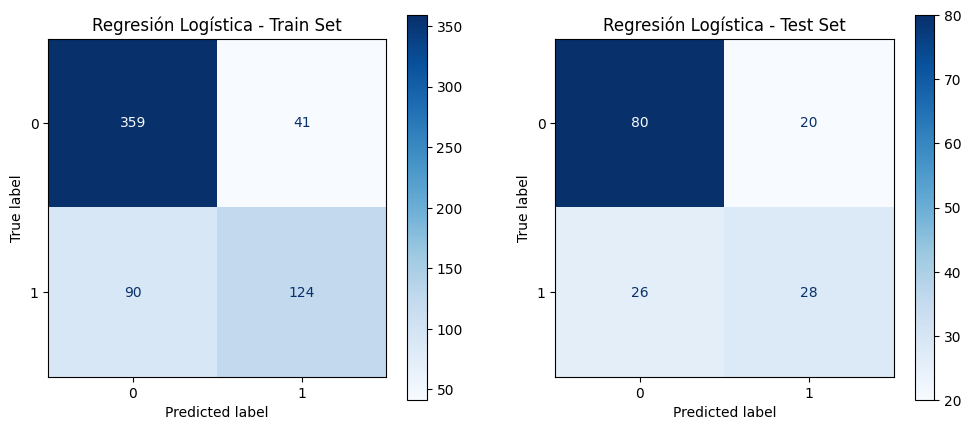


Entrenando SVM...

🔹 Mejor estimador para SVM: SVC(C=10, kernel='linear')
🔹 Mejores hiperparámetros: {'C': 10, 'kernel': 'linear'}



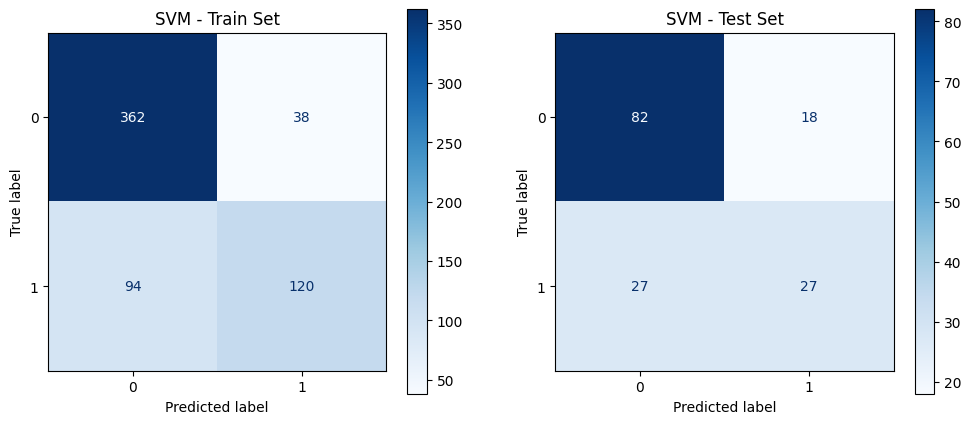


Entrenando Random Forest...

🔹 Mejor estimador para Random Forest: RandomForestClassifier(max_depth=10, random_state=2025)
🔹 Mejores hiperparámetros: {'max_depth': 10, 'n_estimators': 100}



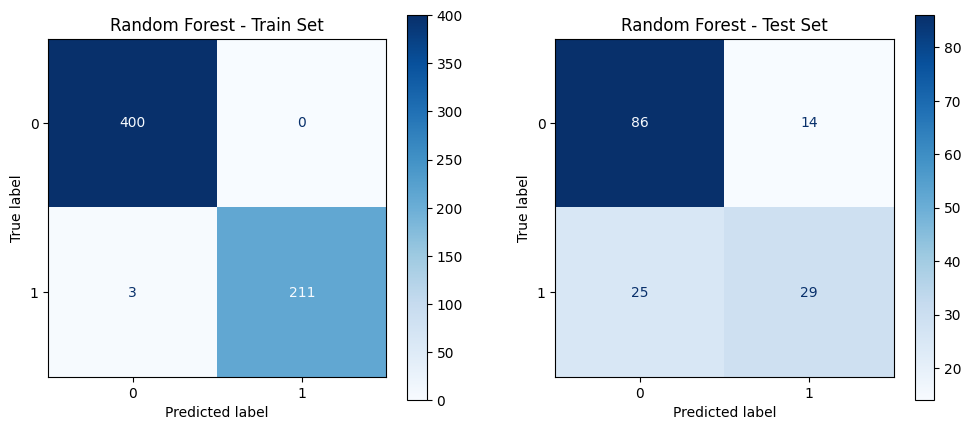


Entrenando XGBoost...


/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [04:56:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)



🔹 Mejor estimador para XGBoost: XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric='logloss',
              feature_types=None, gamma=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.01, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=3,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=200,
              n_jobs=None, num_parallel_tree=None, random_state=2025, ...)
🔹 Mejores hiperparámetros: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 200}



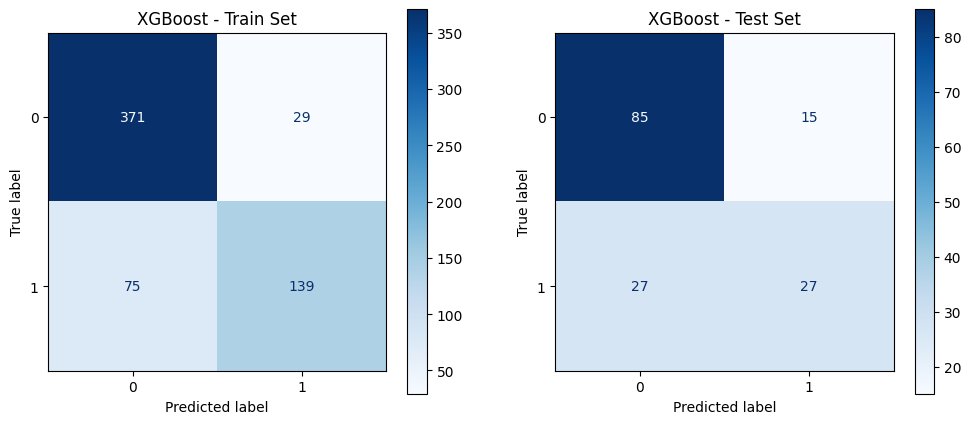


Entrenando KNN...

🔹 Mejor estimador para KNN: KNeighborsClassifier(n_neighbors=7)
🔹 Mejores hiperparámetros: {'n_neighbors': 7, 'weights': 'uniform'}



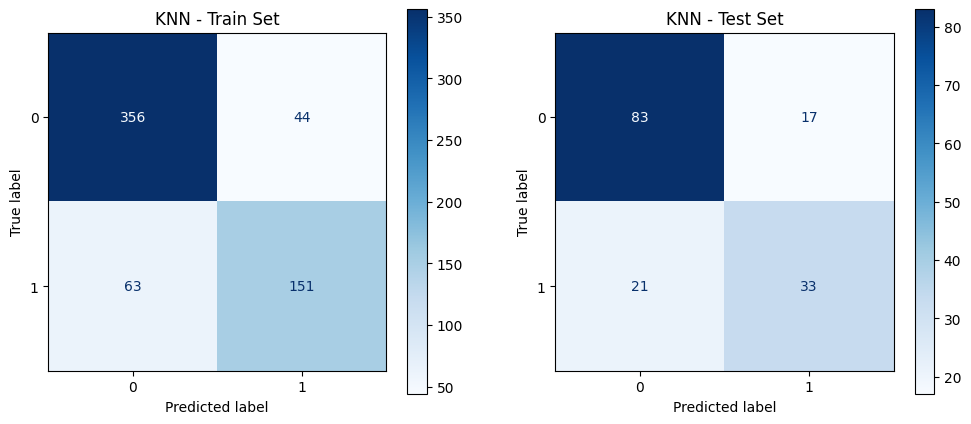

In [64]:
#Ejecutar entrenamiento y evaluación con impresión de los mejores modelos
results, best_estimators = train_and_evaluate_classification(models, param_grids, X_train_scaled, y_train, X_test_scaled, y_test)

In [65]:
# Convertir resultados a DataFrame
results_df = pd.DataFrame(results).T
results_df

,Recall Weighted,Accuracy,Precision,Recall,F1-Score,Best Params
Regresión Logística,0.701299,0.701299,0.694621,0.701299,0.696863,"{'C': 1, 'max_iter': 200}"
SVM,0.707792,0.707792,0.698892,0.707792,0.700802,"{'C': 10, 'kernel': 'linear'}"
Random Forest,0.746753,0.746753,0.739585,0.746753,0.738995,"{'max_depth': 10, 'n_estimators': 100}"
XGBoost,0.727273,0.727273,0.718228,0.727273,0.717946,"{'learning_rate': 0.01, 'max_depth': 3, 'n_est..."
KNN,0.753247,0.753247,0.74966,0.753247,0.750921,"{'n_neighbors': 7, 'weights': 'uniform'}"


from matplotlib import pyplot as plt
import seaborn as sns
_df_0.groupby('index').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
_df_1.groupby('Recall Weighted').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
_df_2.groupby('Accuracy').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
_df_3.groupby('Precision').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
import pandas as pd
plt.subplots(figsize=(8, 8))
df_2dhist = pd.DataFrame({
    x_label: grp['Recall Weighted'].value_counts()
    for x_label, grp in _df_4.groupby('index')
})
sns.heatmap(df_2dhist, cmap='viridis')
plt.xlabel('index')
_ = plt.ylabel('Recall Weighted')

from matplotlib import pyplot as plt
import seaborn as sns
import pandas as pd
plt.subplots(figsize=(8, 8))
df_2dhist = pd.DataFrame({
    x_label: grp['Accuracy'].value_counts()
    for x_label, grp in _df_5.groupby('Recall Weighted')
})
sns.heatmap(df_2dhist, cmap='viridis')
plt.xlabel('Recall Weighted')
_ = plt.ylabel('Accuracy')

from matplotlib import pyplot as plt
import seaborn as sns
import pandas as pd
plt.subplots(figsize=(8, 8))
df_2dhist = pd.DataFrame({
    x_label: grp['Precision'].value_counts()
    for x_label, grp in _df_6.groupby('Accuracy')
})
sns.heatmap(df_2dhist, cmap='viridis')
plt.xlabel('Accuracy')
_ = plt.ylabel('Precision')

from matplotlib import pyplot as plt
import seaborn as sns
import pandas as pd
plt.subplots(figsize=(8, 8))
df_2dhist = pd.DataFrame({
    x_label: grp['Recall'].value_counts()
    for x_label, grp in _df_7.groupby('Precision')
})
sns.heatmap(df_2dhist, cmap='viridis')
plt.xlabel('Precision')
_ = plt.ylabel('Recall')

<Figure size 1200x600 with 0 Axes>

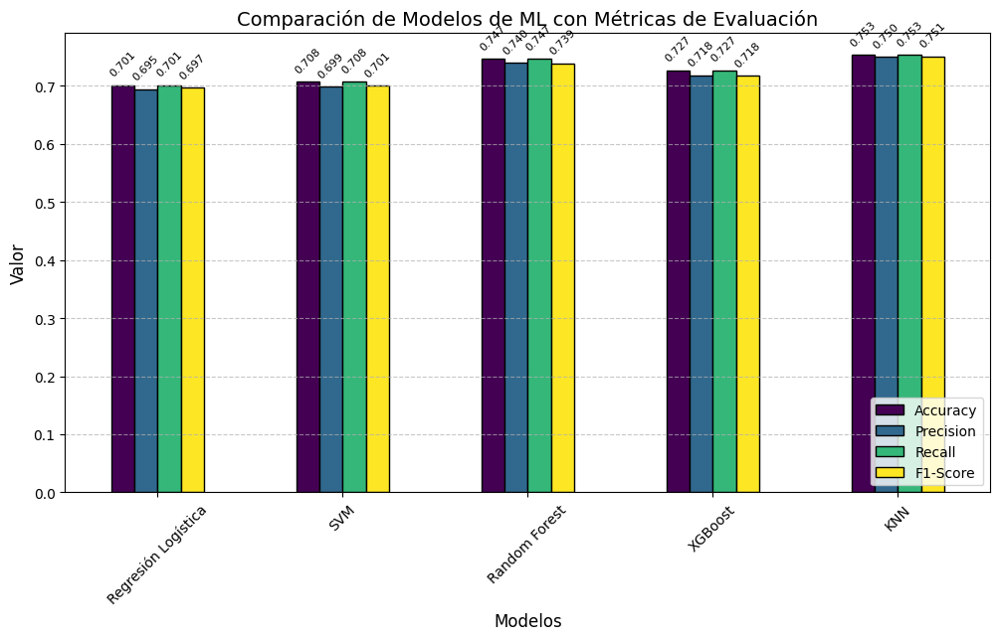

In [68]:
import matplotlib.pyplot as plt

# Seleccionar métricas relevantes para clasificación
metrics = ["Accuracy", "Precision", "Recall", "F1-Score"]

# Crear figura y gráfico de barras
plt.figure(figsize=(12, 6))
ax = results_df[metrics].plot(kind="bar", figsize=(12, 6), colormap="viridis", edgecolor="black")

# Personalizar gráfico
plt.title("Comparación de Modelos de ML con Métricas de Evaluación", fontsize=14)
plt.xlabel("Modelos", fontsize=12)
plt.ylabel("Valor", fontsize=12)
plt.xticks(rotation=45)
plt.legend(loc="lower right", fontsize=10)
plt.grid(axis='y', linestyle="--", alpha=0.7)

# Agregar valores sobre las barras con mejor distribución
for container in ax.containers:
    ax.bar_label(container, fmt="%.3f", fontsize=8, padding=5, label_type="edge", rotation=45)

# Mostrar gráfico
plt.show()



Para evaluar el desempeño de los modelos de clasificación en la detección de diabetes, implementamos la Curva ROC (Receiver Operating Characteristic) y calculamos el AUC (Área Bajo la Curva). Esta métrica nos permite analizar la capacidad de los modelos para distinguir entre pacientes con y sin diabetes, considerando el equilibrio entre la tasa de verdaderos positivos (sensibilidad) y la tasa de falsos positivos en distintos umbrales de decisión. Dado que en problemas médicos como este es crucial minimizar los falsos negativos, la Curva ROC nos ayuda a comparar qué modelo ofrece la mejor discriminación entre clases y cuál podría requerir ajustes adicionales en su umbral de decisión.

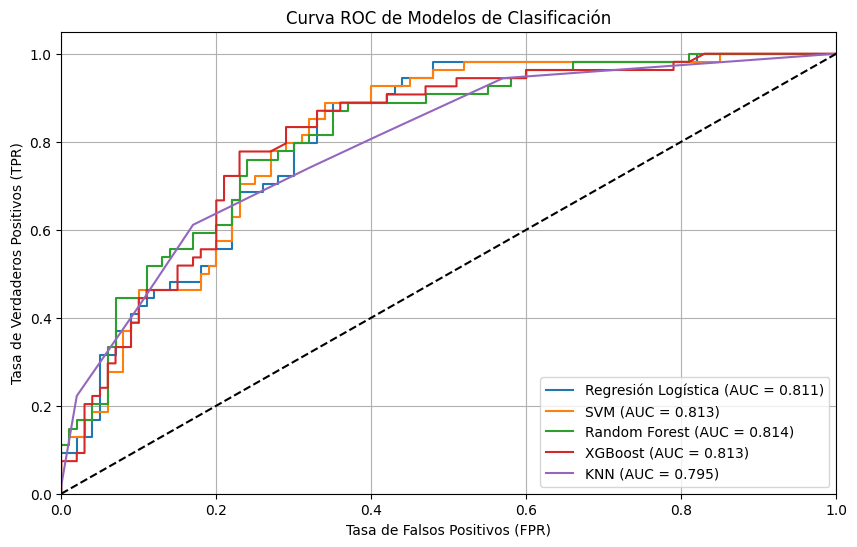

In [69]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

# Diccionario de modelos entrenados
models = best_estimators

plt.figure(figsize=(10, 6))

for name, model in models.items():
    # Obtener probabilidades predichas
    if hasattr(model, "predict_proba"):
        y_scores = model.predict_proba(X_test_scaled)[:, 1]  # Solo la probabilidad de la clase positiva
    else:
        y_scores = model.decision_function(X_test_scaled)  # Para SVM

    # Calcular curva ROC
    fpr, tpr, _ = roc_curve(y_test, y_scores)
    roc_auc = auc(fpr, tpr)

    # Graficar curva ROC
    plt.plot(fpr, tpr, label=f'{name} (AUC = {roc_auc:.3f})')

# Ajustes del gráfico
plt.plot([0, 1], [0, 1], 'k--')  # Línea base de azar
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Tasa de Falsos Positivos (FPR)')
plt.ylabel('Tasa de Verdaderos Positivos (TPR)')
plt.title('Curva ROC de Modelos de Clasificación')
plt.legend(loc="lower right")
plt.grid()
plt.show()


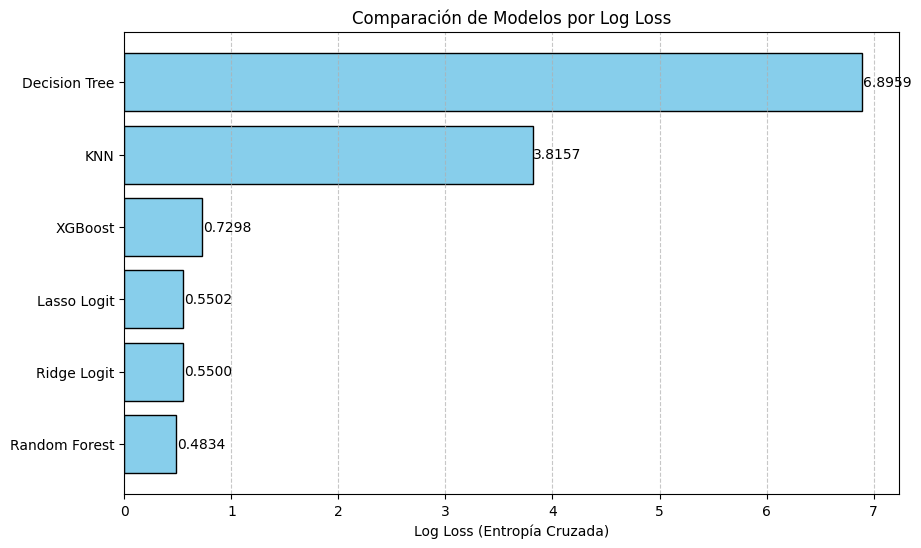

In [90]:
calcular entropia

#### Preparación SMOTE

In [70]:
print(y_train.value_counts(normalize=True))

Outcome
0    0.651466
1    0.348534
Name: proportion, dtype: float64


### **SMOTE: Synthetic Minority Over-sampling Technique**

#### Introducción

En problemas de clasificación con conjuntos de datos desbalanceados, los modelos tienden a favorecer la clase mayoritaria, lo que puede afectar la precisión y generalización del modelo. **SMOTE (Synthetic Minority Over-sampling Technique)** es una técnica que aborda este desbalance generando ejemplos sintéticos de la clase minoritaria, en lugar de simplemente replicar instancias existentes.

#### ¿Cómo funciona SMOTE?

1. **Selección de vecinos más cercanos**: Para cada instancia de la clase minoritaria, se identifican sus *k* vecinos más cercanos en el espacio de características.
2. **Generación de ejemplos sintéticos**: Para cada vecino seleccionado, se crea un nuevo ejemplo sintético mediante la interpolación lineal entre la instancia original y el vecino. Esto se logra con la fórmula:

   $x_{\text{nuevo}} = x_i + \delta \times (x_{\text{vecino}} - x_i)$

   donde $x_i$ es la instancia original, $x_{\text{vecino}}$ es uno de sus vecinos más cercanos, y $\delta$ es un número aleatorio en el intervalo $[0, 1]$.

3. **Aumento del conjunto de datos**: Los ejemplos sintéticos generados se añaden al conjunto de datos, equilibrando así la proporción entre las clases.

#### Consideraciones al utilizar SMOTE

- **No aporta nueva información real**: Los ejemplos sintéticos se generan a partir de combinaciones de instancias existentes, por lo que no introducen nueva información al modelo.
- **Posible generación de ruido**: Si las clases no están claramente separadas, SMOTE puede crear ejemplos sintéticos que se solapan con la clase mayoritaria, introduciendo ruido y afectando negativamente al rendimiento del modelo.
- **Efectividad variable según el algoritmo**: SMOTE suele ser beneficioso para algoritmos sensibles a la distribución de clases, como árboles de decisión o máquinas de vectores de soporte. Sin embargo, su impacto puede ser limitado en modelos como redes neuronales profundas.
- **Dimensionalidad de los datos**: En conjuntos de datos con alta dimensionalidad, SMOTE puede ser menos efectivo debido a la dispersión de los datos en espacios de alta dimensión.
- **Selección de hiperparámetros**: Es crucial elegir adecuadamente el número de vecinos ($k$) y la proporción de sobremuestreo para evitar el sobreajuste y garantizar que los ejemplos sintéticos sean representativos.

#### Referencias

- Chawla, N. V., Bowyer, K. W., Hall, L. O., & Kegelmeyer, W. P. (2002). [SMOTE: Synthetic Minority Over-sampling Technique](https://arxiv.org/abs/1106.1813). Journal of Artificial Intelligence Research, 16, 321-357.
- Sakho, A., Malherbe, E., & Scornet, E. (2024). [Do we need rebalancing strategies? A theoretical and empirical study around SMOTE and its variants](https://arxiv.org/abs/2402.03819).

In [72]:
from imblearn.over_sampling import SMOTE
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Definir semilla para reproducibilidad
SEED = 2025

In [73]:
# Aplicar SMOTE para balancear las clases en el conjunto de entrenamiento
smote = SMOTE(random_state=SEED)
X_train_balanced, y_train_balanced = smote.fit_resample(X_train_scaled, y_train)

# Definir modelos de clasificación
classification_models = {
    "SVM": SVC(random_state=SEED),
    "Decision Tree": DecisionTreeClassifier(random_state=SEED),
    "Ridge Logit": LogisticRegression(penalty='l2', solver='liblinear', random_state=SEED),
    "Lasso Logit": LogisticRegression(penalty='l1', solver='liblinear', random_state=SEED),
    "Random Forest": RandomForestClassifier(random_state=SEED),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=SEED),
    "KNN": KNeighborsClassifier()
}

# Confirmar que el conjunto está balanceado
from collections import Counter
print("Distribución de clases después de SMOTE:", Counter(y_train_balanced))

Distribución de clases después de SMOTE: Counter({0: 400, 1: 400})


In [75]:
# Definir hiperparámetros para GridSearchCV
classification_param_grids = {
    "SVM": {"C": [0.1, 1, 10], "kernel": ["linear", "rbf"]},
    "Decision Tree": {"max_depth": [None, 10, 20], "min_samples_split": [2, 5, 10]},
    "Ridge Logit": {"C": [0.01, 0.1, 1, 10], "penalty": ["l2"]},
    "Lasso Logit": {"C": [0.01, 0.1, 1, 10], "penalty": ["l1"]},
    "Random Forest": {"n_estimators": [50, 100, 200], "max_depth": [None, 10, 20]},
    "XGBoost": {"n_estimators": [50, 100, 200], "max_depth": [3, 6, 10], "learning_rate": [0.01, 0.1, 0.3]},
    "KNN": {"n_neighbors": [3, 5, 7, 9], "weights": ["uniform", "distance"]}
}


In [76]:
print(y_train_balanced)

0      0
1      0
2      0
3      0
4      0
      ..
795    1
796    1
797    1
798    1
799    1
Name: Outcome, Length: 800, dtype: int64


Entrenando SVM...

🔹 Mejor estimador para SVM: SVC(C=10, random_state=2025)
🔹 Mejores hiperparámetros: {'C': 10, 'kernel': 'rbf'}



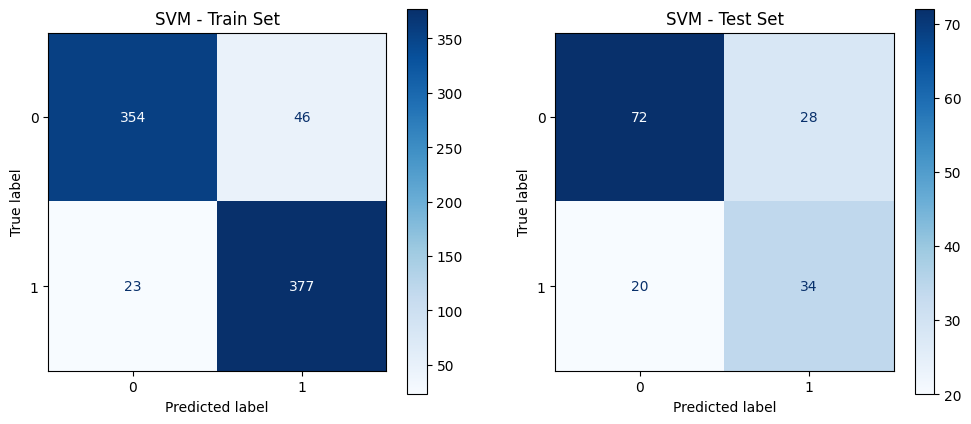


Entrenando Decision Tree...

🔹 Mejor estimador para Decision Tree: DecisionTreeClassifier(max_depth=10, random_state=2025)
🔹 Mejores hiperparámetros: {'max_depth': 10, 'min_samples_split': 2}



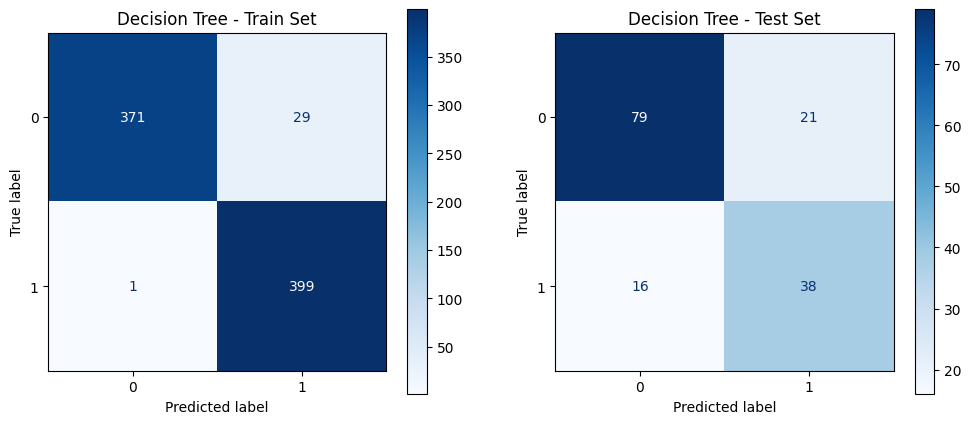


Entrenando Ridge Logit...

🔹 Mejor estimador para Ridge Logit: LogisticRegression(C=1, random_state=2025, solver='liblinear')
🔹 Mejores hiperparámetros: {'C': 1, 'penalty': 'l2'}



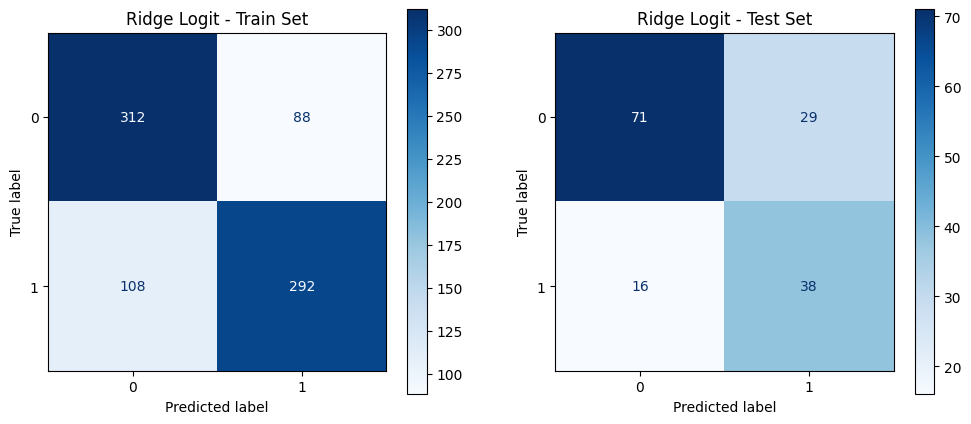


Entrenando Lasso Logit...

🔹 Mejor estimador para Lasso Logit: LogisticRegression(C=1, penalty='l1', random_state=2025, solver='liblinear')
🔹 Mejores hiperparámetros: {'C': 1, 'penalty': 'l1'}



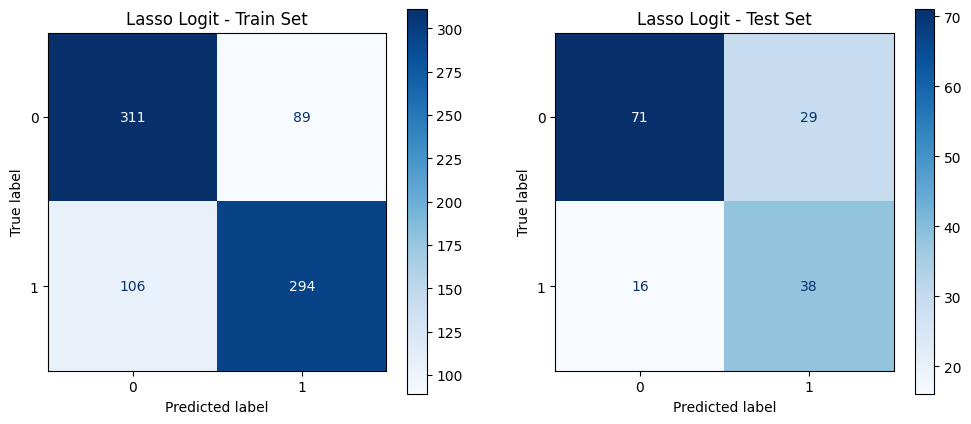


Entrenando Random Forest...

🔹 Mejor estimador para Random Forest: RandomForestClassifier(n_estimators=200, random_state=2025)
🔹 Mejores hiperparámetros: {'max_depth': None, 'n_estimators': 200}



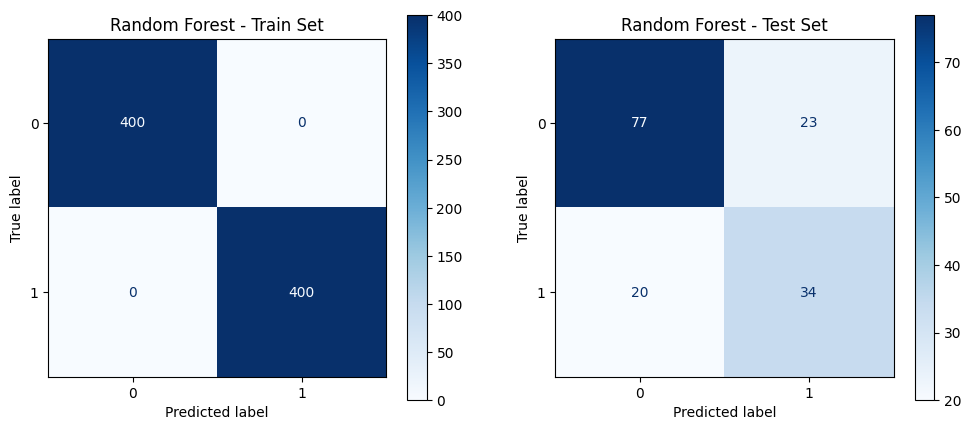


Entrenando XGBoost...


/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [05:53:18] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)



🔹 Mejor estimador para XGBoost: XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric='logloss',
              feature_types=None, gamma=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=0.3, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=10,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=50,
              n_jobs=None, num_parallel_tree=None, random_state=2025, ...)
🔹 Mejores hiperparámetros: {'learning_rate': 0.3, 'max_depth': 10, 'n_estimators': 50}



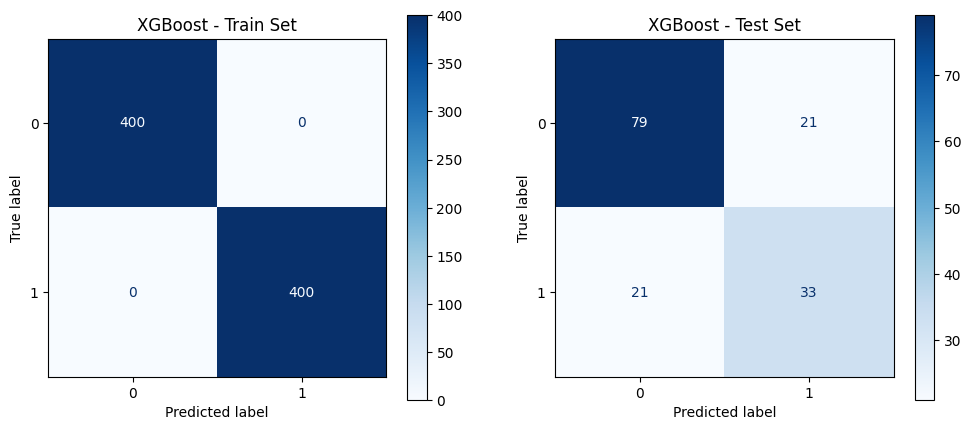


Entrenando KNN...

🔹 Mejor estimador para KNN: KNeighborsClassifier(n_neighbors=3, weights='distance')
🔹 Mejores hiperparámetros: {'n_neighbors': 3, 'weights': 'distance'}



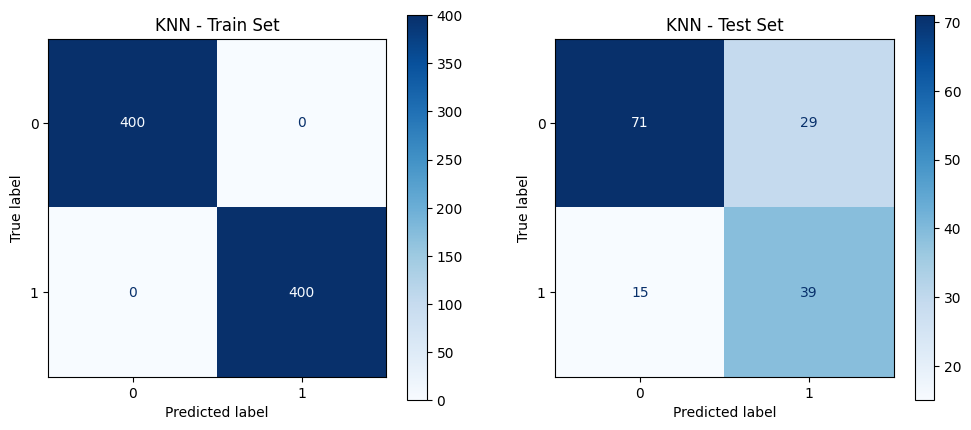

In [77]:
# Ejecutar entrenamiento y evaluación con el conjunto balanceado por SMOTE
classification_results, classification_best_estimators = train_and_evaluate_classification(
    classification_models, classification_param_grids,
    X_train_balanced, y_train_balanced, X_test_scaled, y_test
)

In [79]:
# Convertir resultados a DataFrame y mostrar
classification_results_df = pd.DataFrame(classification_results).T
classification_results_df

,Recall Weighted,Accuracy,Precision,Recall,F1-Score,Best Params
SVM,0.688312,0.688312,0.700479,0.688312,0.692566,"{'C': 10, 'kernel': 'rbf'}"
Decision Tree,0.75974,0.75974,0.765828,0.75974,0.761975,"{'max_depth': 10, 'min_samples_split': 2}"
Ridge Logit,0.707792,0.707792,0.728806,0.707792,0.713332,"{'C': 1, 'penalty': 'l2'}"
Lasso Logit,0.707792,0.707792,0.728806,0.707792,0.713332,"{'C': 1, 'penalty': 'l1'}"
Random Forest,0.720779,0.720779,0.724623,0.720779,0.722426,"{'max_depth': None, 'n_estimators': 200}"
XGBoost,0.727273,0.727273,0.727273,0.727273,0.727273,"{'learning_rate': 0.3, 'max_depth': 10, 'n_est..."
KNN,0.714286,0.714286,0.7372,0.714286,0.719926,"{'n_neighbors': 3, 'weights': 'distance'}"


from matplotlib import pyplot as plt
import seaborn as sns
_df_8.groupby('index').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
_df_9.groupby('Recall Weighted').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
_df_10.groupby('Accuracy').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
_df_11.groupby('Precision').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
import pandas as pd
plt.subplots(figsize=(8, 8))
df_2dhist = pd.DataFrame({
    x_label: grp['Recall Weighted'].value_counts()
    for x_label, grp in _df_12.groupby('index')
})
sns.heatmap(df_2dhist, cmap='viridis')
plt.xlabel('index')
_ = plt.ylabel('Recall Weighted')

from matplotlib import pyplot as plt
import seaborn as sns
import pandas as pd
plt.subplots(figsize=(8, 8))
df_2dhist = pd.DataFrame({
    x_label: grp['Accuracy'].value_counts()
    for x_label, grp in _df_13.groupby('Recall Weighted')
})
sns.heatmap(df_2dhist, cmap='viridis')
plt.xlabel('Recall Weighted')
_ = plt.ylabel('Accuracy')

from matplotlib import pyplot as plt
import seaborn as sns
import pandas as pd
plt.subplots(figsize=(8, 8))
df_2dhist = pd.DataFrame({
    x_label: grp['Precision'].value_counts()
    for x_label, grp in _df_14.groupby('Accuracy')
})
sns.heatmap(df_2dhist, cmap='viridis')
plt.xlabel('Accuracy')
_ = plt.ylabel('Precision')

from matplotlib import pyplot as plt
import seaborn as sns
import pandas as pd
plt.subplots(figsize=(8, 8))
df_2dhist = pd.DataFrame({
    x_label: grp['Recall'].value_counts()
    for x_label, grp in _df_15.groupby('Precision')
})
sns.heatmap(df_2dhist, cmap='viridis')
plt.xlabel('Precision')
_ = plt.ylabel('Recall')

<Figure size 1200x600 with 0 Axes>

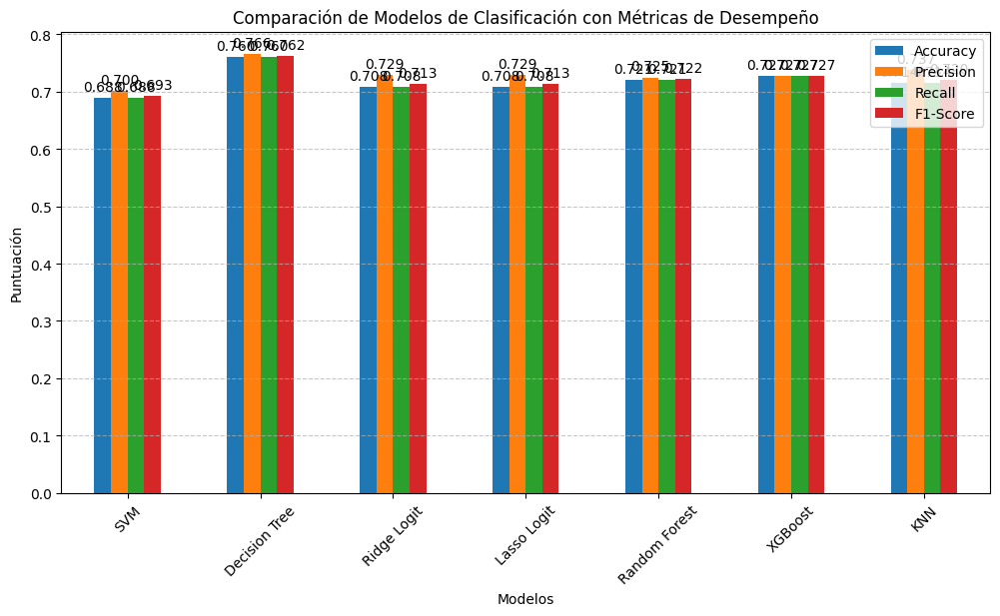

In [86]:
# Graficar resultados con etiquetas de valores en las barras
plt.figure(figsize=(12, 6))
ax = classification_results_df[['Accuracy', 'Precision', 'Recall', 'F1-Score']].plot(kind='bar', figsize=(12, 6))

# Agregar etiquetas a las barras con los valores
for container in ax.containers:
    ax.bar_label(container, fmt='%.3f', label_type='edge', fontsize=10, padding=3)

plt.title("Comparación de Modelos de Clasificación con Métricas de Desempeño")
plt.xlabel("Modelos")
plt.ylabel("Puntuación")
plt.xticks(rotation=45)
plt.legend(loc="upper right")
plt.grid(axis='y', linestyle='--', alpha=0.7)  # Agregar líneas de referencia
plt.show()


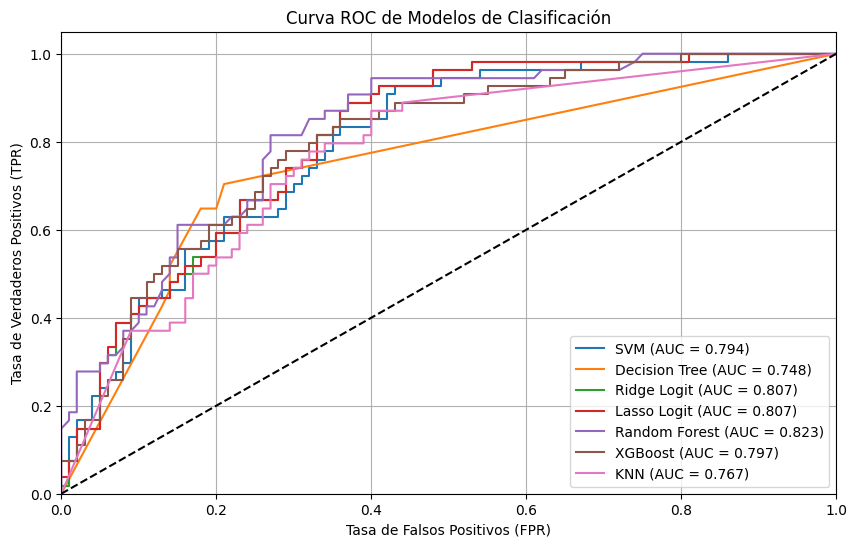

In [87]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

# Crear la figura
plt.figure(figsize=(10, 6))

# Evaluar cada modelo en la curva ROC
for name, model in classification_best_estimators.items():
    if hasattr(model, "predict_proba"):
        y_scores = model.predict_proba(X_test_scaled)[:, 1]  # Probabilidad de la clase positiva
    else:
        y_scores = model.decision_function(X_test_scaled)  # Para SVM

    # Calcular la curva ROC
    fpr, tpr, _ = roc_curve(y_test, y_scores)
    roc_auc = auc(fpr, tpr)

    # Graficar la curva ROC
    plt.plot(fpr, tpr, label=f'{name} (AUC = {roc_auc:.3f})')

# Agregar línea base de azar
plt.plot([0, 1], [0, 1], 'k--')

# Configuración del gráfico
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Tasa de Falsos Positivos (FPR)')
plt.ylabel('Tasa de Verdaderos Positivos (TPR)')
plt.title('Curva ROC de Modelos de Clasificación')
plt.legend(loc="lower right")
plt.grid()
plt.show()


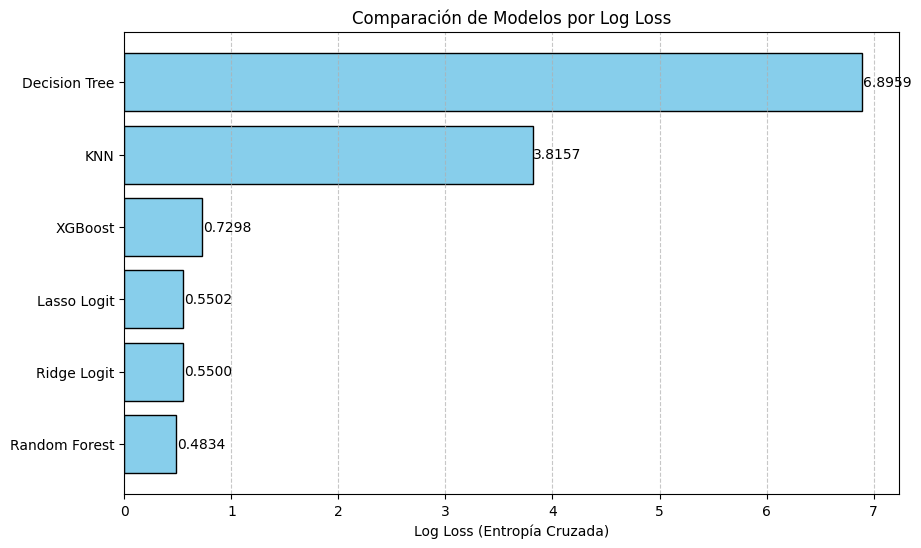

In [89]:
import matplotlib.pyplot as plt
from sklearn.metrics import log_loss

# Calcular la entropía cruzada para cada modelo
log_loss_results = {}

for name, model in classification_best_estimators.items():
    if hasattr(model, "predict_proba"):
        y_probs = model.predict_proba(X_test_scaled)
        loss = log_loss(y_test, y_probs)
        log_loss_results[name] = loss

# Convertir resultados a DataFrame
log_loss_df = pd.DataFrame(list(log_loss_results.items()), columns=["Modelo", "Log Loss"]).sort_values(by="Log Loss")

# Graficar resultados
plt.figure(figsize=(10, 6))
ax = plt.barh(log_loss_df["Modelo"], log_loss_df["Log Loss"], color="skyblue", edgecolor="black")

# Agregar etiquetas a las barras
for i, v in enumerate(log_loss_df["Log Loss"]):
    plt.text(v + 0.005, i, f"{v:.4f}", va="center", fontsize=10)

plt.xlabel("Log Loss (Entropía Cruzada)")
plt.title("Comparación de Modelos por Log Loss")
plt.grid(axis='x', linestyle="--", alpha=0.7)
plt.show()
